In [1]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 7 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'UCI_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UCI_MotionSense_KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'  # Substitua pelo caminho do modelo pré-treinado
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
from pathlib import Path
from dataset import load_dataset
# import TSNE
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt


In [3]:
data_loaders, dataset_sizes = load_dataset(args)


Data Raw (575098, 6)
Data (23002, 50, 6)
Labels (23002,)
Data Raw (79731, 6)
Data (3188, 50, 6)
Labels (3188,)
Data Raw (161999, 6)
Data (6478, 50, 6)
Labels (6478,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 23002, 'val': 3188, 'test': 6478}
Dataset size for train: 23002
Dataset size for val: 3188
Dataset size for test: 6478


In [17]:
class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 7 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'MotionSense_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UCI_MotionSense_KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'  # Substitua pelo caminho do modelo pré-treinado
        self.data_percentage = 100
args = Args()

data_loaders, dataset_sizes = load_dataset(args)

Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754


In [18]:
class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 7 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'KuHar_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UCI_MotionSense_KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'  # Substitua pelo caminho do modelo pré-treinado
        self.data_percentage = 100
args = Args()

data_loaders, dataset_sizes = load_dataset(args)

Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522


In [3]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne_cpc = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)
Data Raw (73075, 6)
Data (2922, 50, 6)
Labels (2922,)
Data Raw (148030, 6)
Data (5920, 50, 6)
Labels (5920,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 21125, 'val': 2922, 'test': 5920}
Dataset size for train: 21125
Dataset size for val: 2922
Dataset size for test: 5920
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7f92582ea920>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7f925824f910>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7f9003cd2860>}
Embeddings torch.Size([21125, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

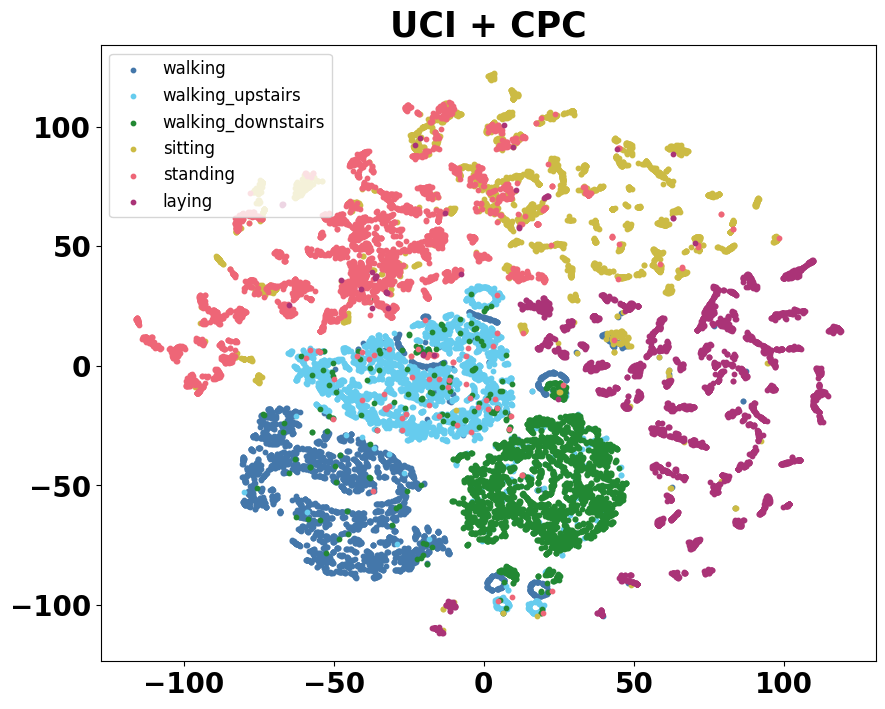

In [4]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('UCI + CPC', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()


In [13]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)


Data Raw (73075, 6)
Data (2922, 50, 6)
Labels (2922,)
Data Raw (148030, 6)
Data (5920, 50, 6)
Labels (5920,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 21125, 'val': 2922, 'test': 5920}
Dataset size for train: 21125
Dataset size for val: 2922
Dataset size for test: 5920
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7f556a597a90>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7f556a3b7be0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7f556a343b80>}
FFT Magnitude (21125, 50, 6)
Embeddings (21125, 300)


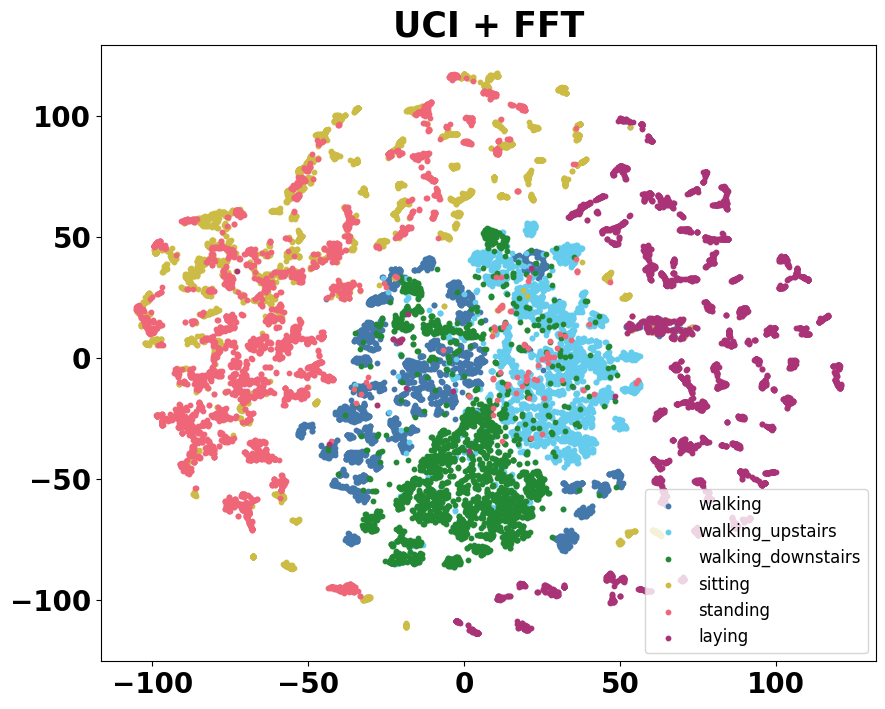

In [14]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('UCI + FFT', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [5]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
from dataset import HARDataset

dataset = HARDataset(args, 'train')
print("Dataset", dataset)
inputs = dataset.data_raw['train']['data']
inputs = torch.tensor(inputs, dtype=torch.float32)
print("Shape of inputs:", inputs.shape)
labels = dataset.data_raw['train']['labels']
labels = torch.tensor(labels, dtype=torch.long)
#print("Shape of embeddings_tsne:", embeddings_tsne.shape)
print("Shape of labels:", labels.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)
Dataset <dataset.HARDataset object at 0x7f5792bcbd00>
Shape of inputs: torch.Size([528157, 6])
Shape of labels: torch.Size([528157])


Shape of embeddings_tsne: (528157, 2)
Shape of labels: torch.Size([528157])


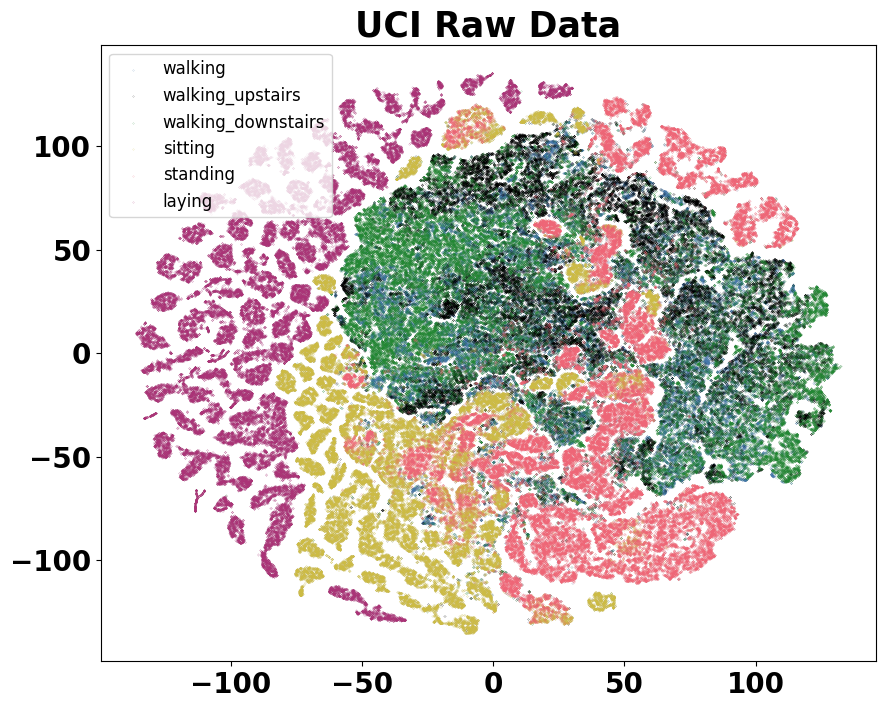

In [15]:
print("Shape of embeddings_tsne:", embeddings_tsne.shape)
print("Shape of labels:", labels.shape)

# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#000000", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}

plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=.01, c=colors[i], label=f'{dic[i]}')

plt.legend(fontsize=12)
plt.title('UCI Raw Data', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

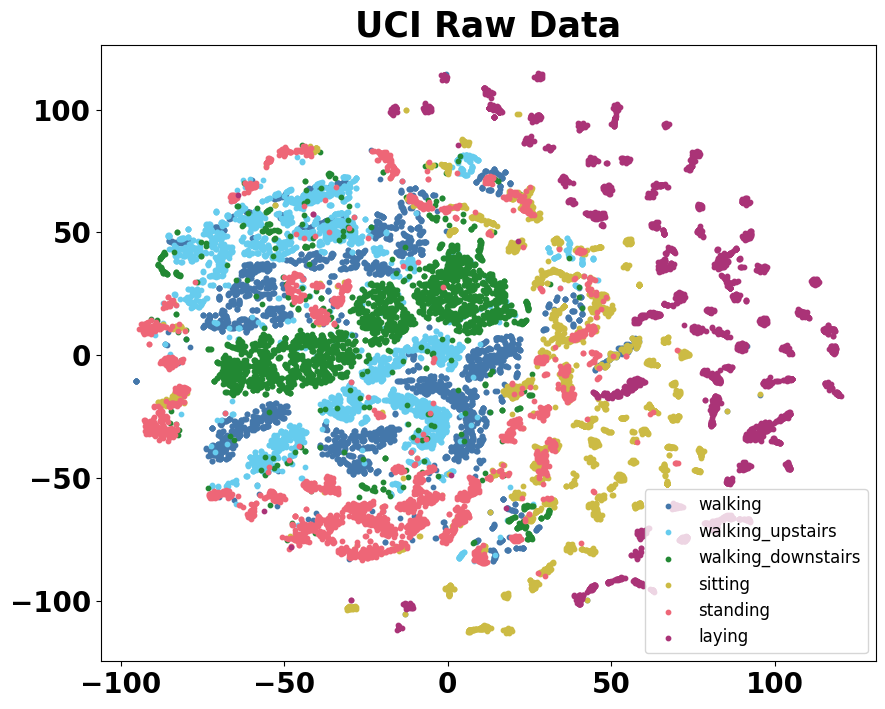

In [6]:
            # Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('UCI Raw Data', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [2]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 6 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'MotionSense_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UKM_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [6]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b08b2680>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b08f8670>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b083ee00>}
Embeddings torch.Size([40106, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

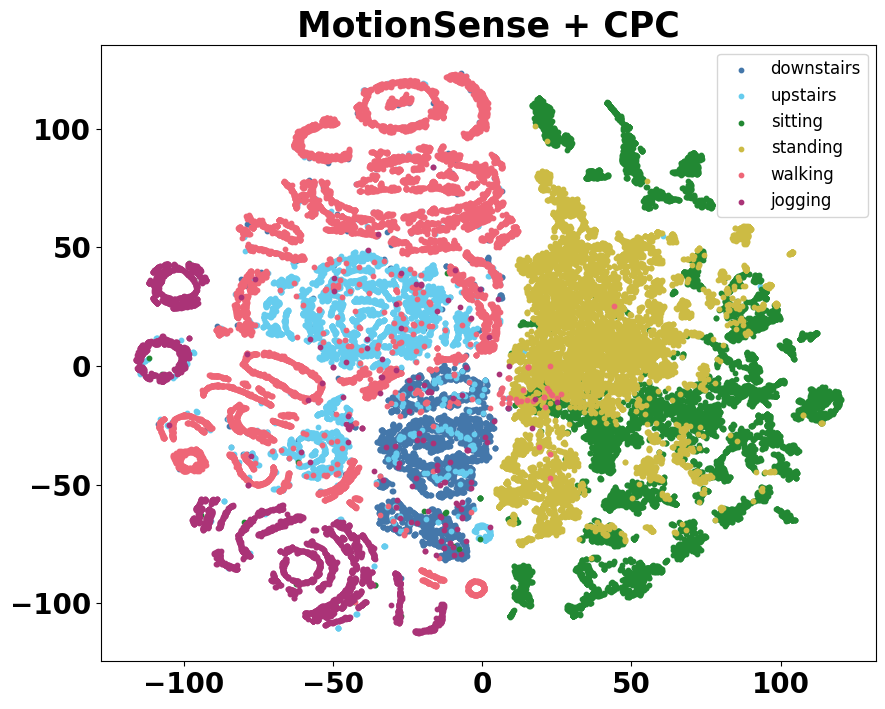

In [7]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('MotionSense + CPC', fontsize=25, fontweight='bold')

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [8]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b64059c0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b08c4460>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fe5c2dddb70>}
FFT Magnitude (40106, 50, 6)
Embeddings (40106, 300)


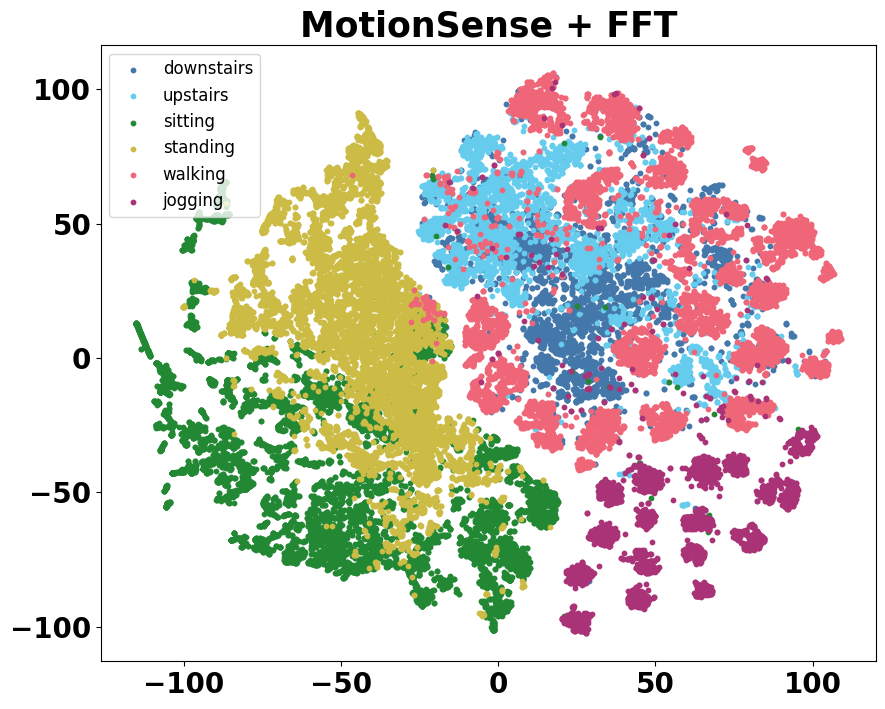

In [9]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('MotionSense + FFT', fontsize=25, fontweight='bold')
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')
plt.show()

In [11]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b64067d0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b650b9d0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fe5b08c4460>}
Embeddings torch.Size([40106, 300])


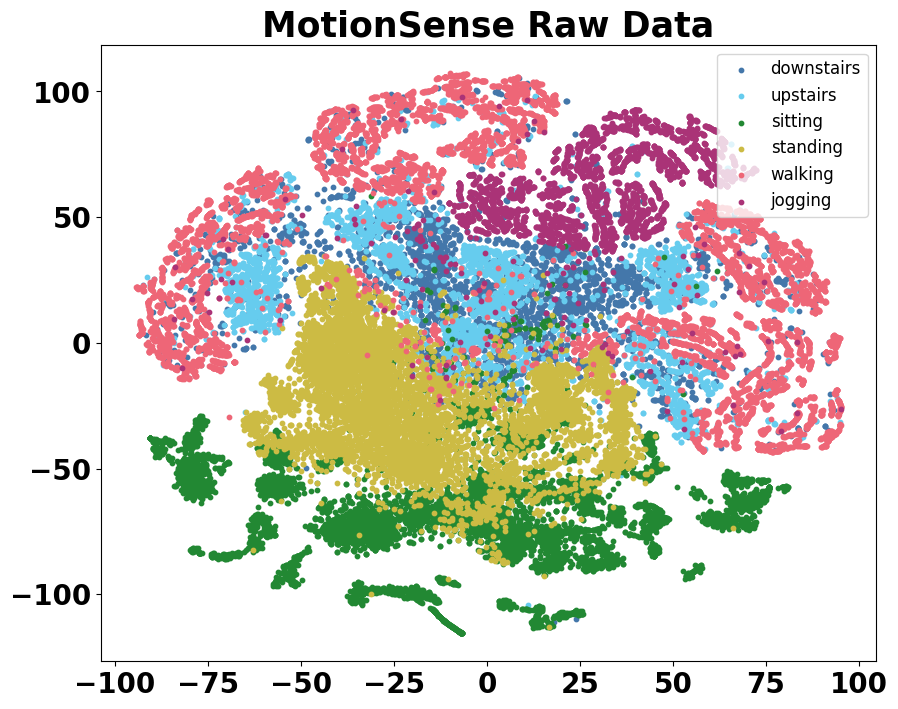

In [13]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
plt.legend(fontsize=12)
plt.title('MotionSense Raw Data', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()


In [2]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 18 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'KuHar_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/May-26-2024/KuHar_MotionSense_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [5]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c8becbb0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c7470340>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c74729e0>}
Embeddings torch.Size([93072, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

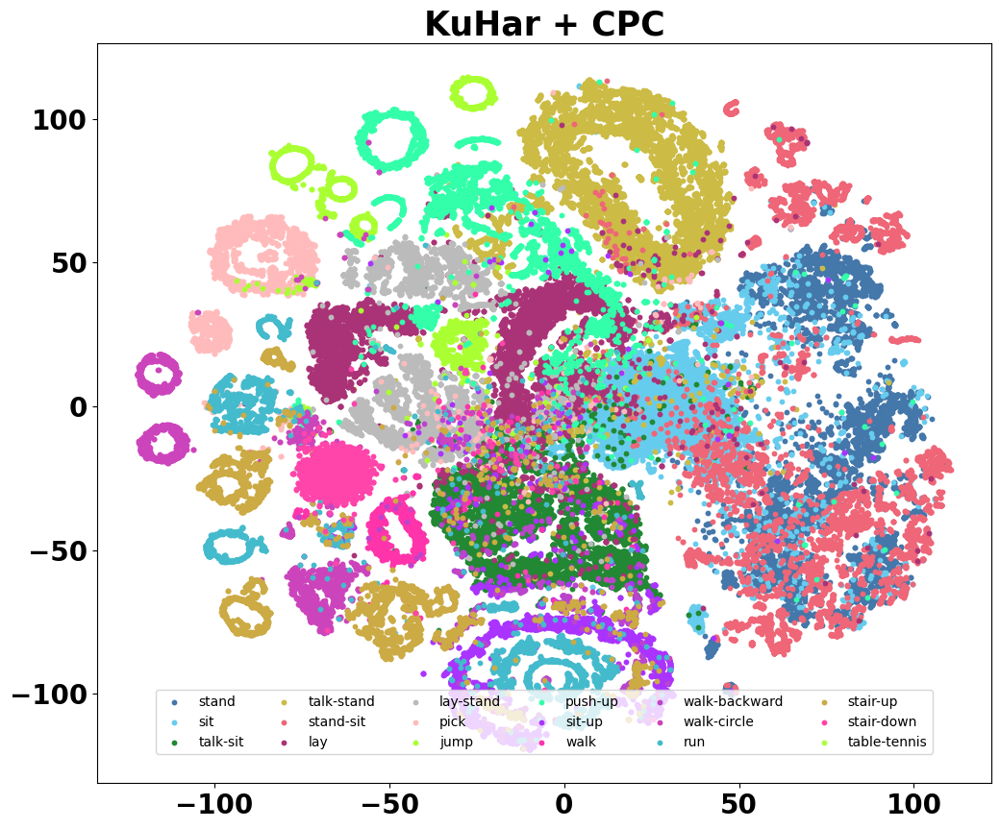

In [9]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(12, 10))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('KuHar + CPC', fontsize=25, fontweight='bold') 
plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [10]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff406db35b0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c09335b0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff195dda320>}
FFT Magnitude (93072, 50, 6)
Embeddings (93072, 300)


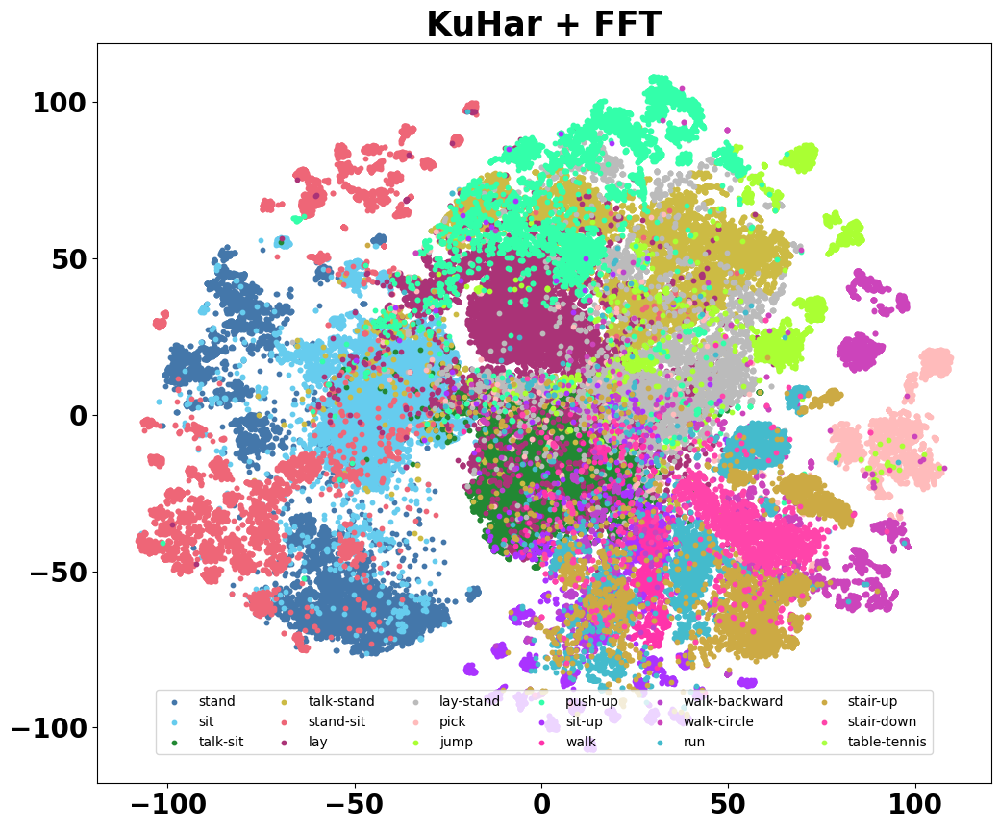

In [11]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(12, 10))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
plt.title('KuHar + FFT', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [12]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c689a800>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c6898670>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c6898eb0>}
Embeddings torch.Size([93072, 300])


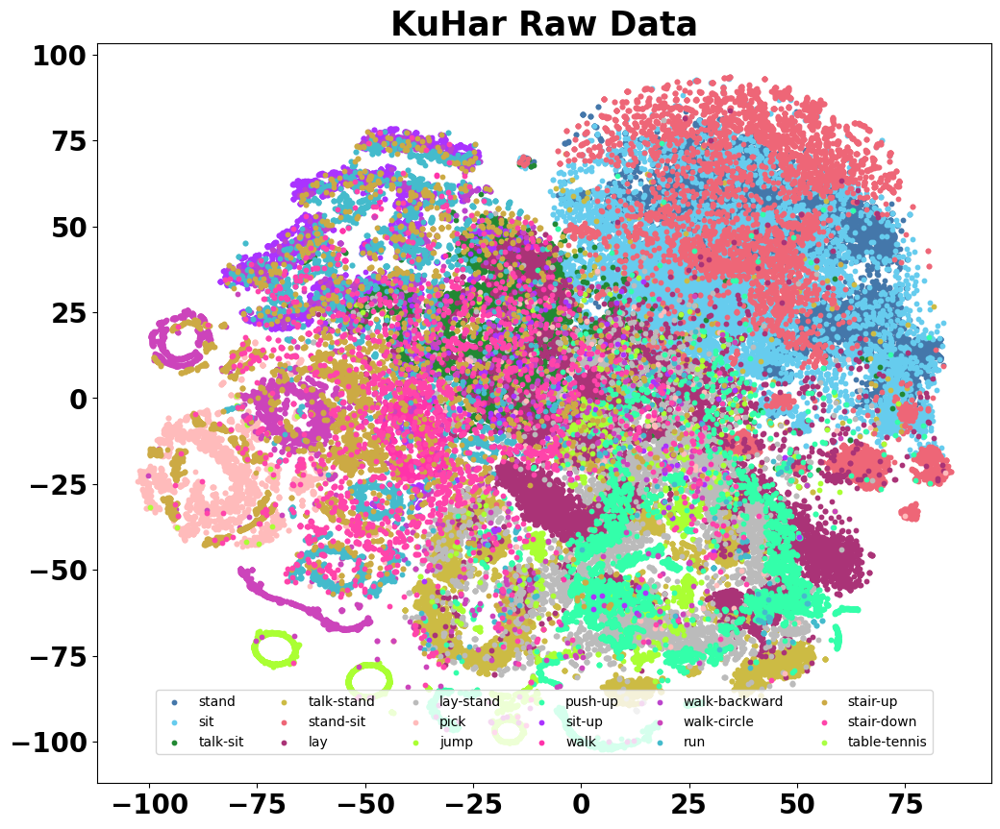

In [13]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(12, 10))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('KuHar Raw Data', fontsize=25, fontweight='bold') 
plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [14]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 9 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'RealWorld_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [15]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
from pathlib import Path
from dataset import load_dataset
# import TSNE
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt


In [25]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff195d91e10>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff195d928c0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c0939300>}
Embeddings torch.Size([90550, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

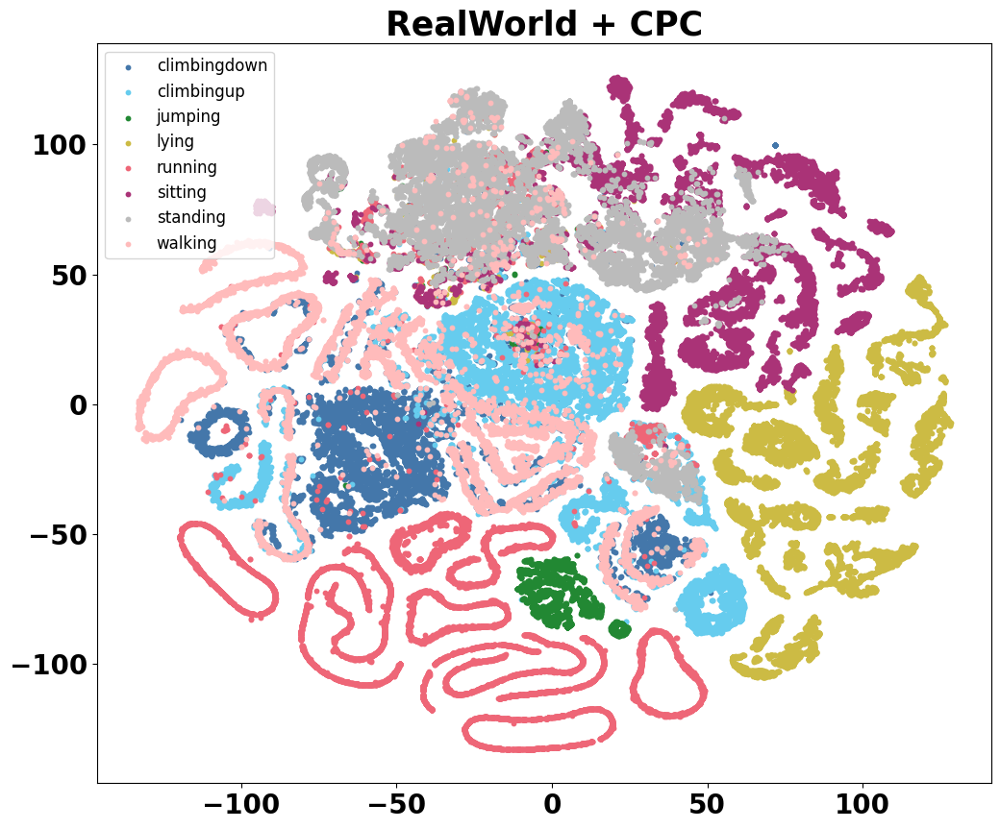

In [26]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(12, 10))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('RealWorld + CPC', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=3, bbox_to_anchor=(0.5, 0.03))
plt.legend(fontsize=12)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [24]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff1951bdd80>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff1951bed70>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff1951bffd0>}
FFT Magnitude (90550, 50, 6)
Embeddings (90550, 300)


KeyboardInterrupt: 

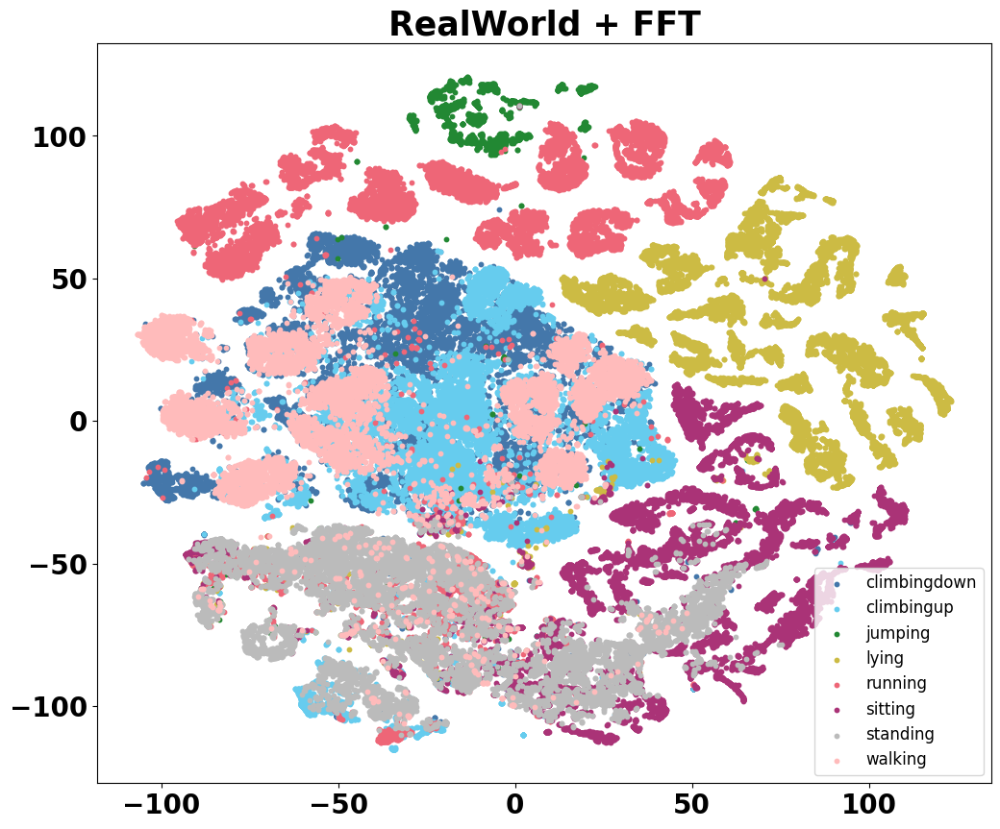

In [23]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(12, 10))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
plt.title('RealWorld + FFT', fontsize=25, fontweight='bold') 
plt.legend(fontsize=12)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [27]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7ff1c08cef50>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7ff19523f8b0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7ff19523f8e0>}
Embeddings torch.Size([90550, 300])


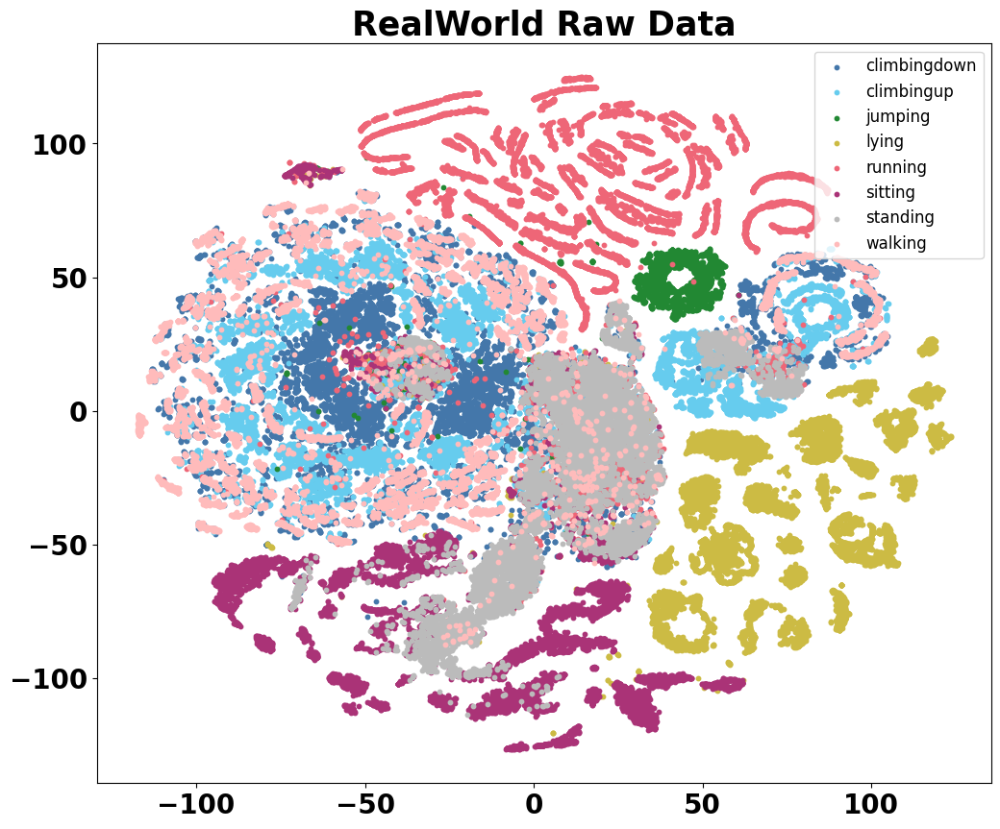

In [29]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(12, 10))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('RealWorld Raw Data', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
plt.legend(fontsize=12)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')
plt.show()